# **1. Introduction**

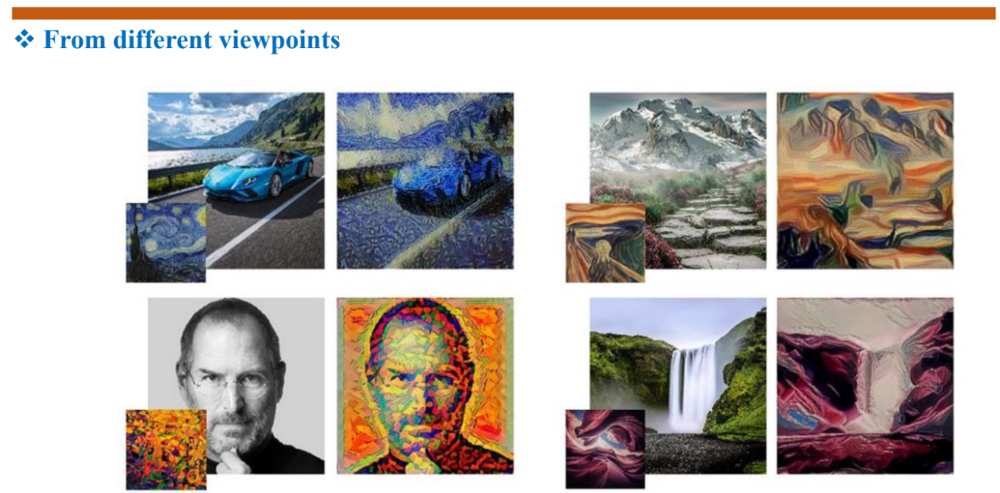

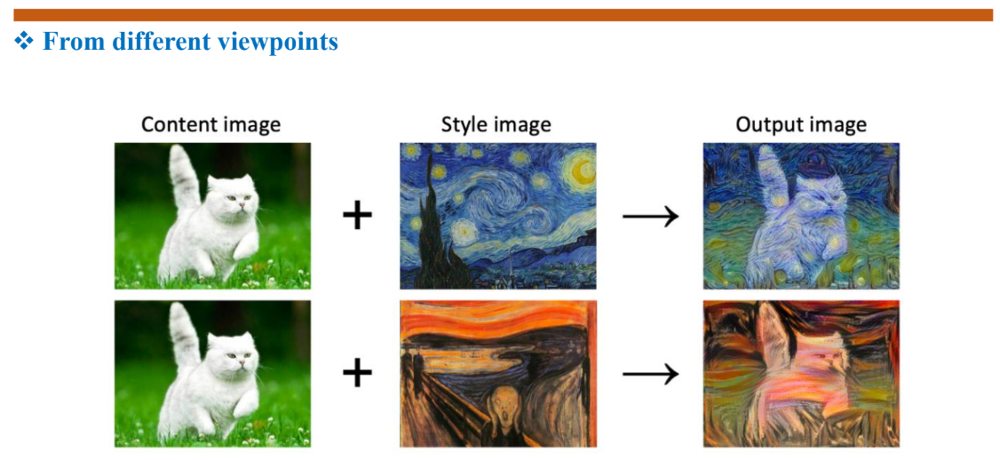

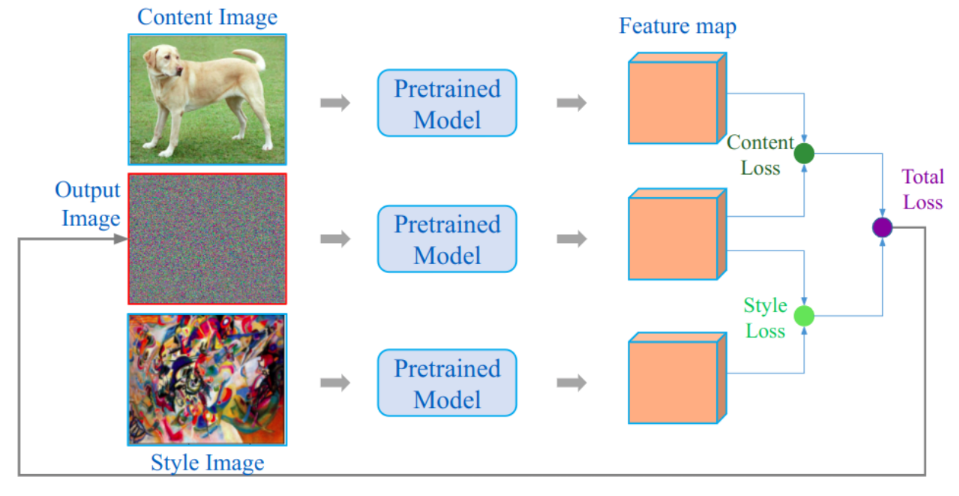

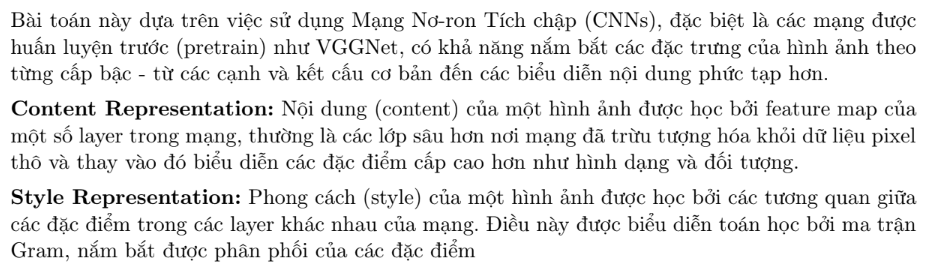

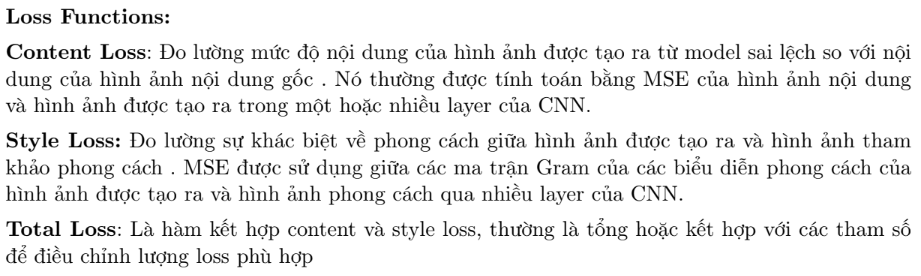

## inputs as variables

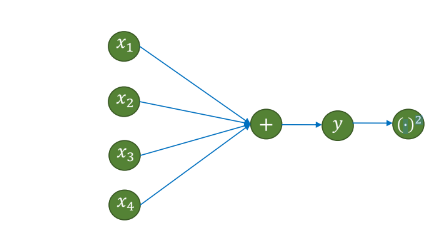

In [ ]:
import torch
from torch.autograd import Variable

x = torch.Tensor([[1.0, 1.0],
                  [1.0, 1.0]])
x = Variable(x, requires_grad=True)
y = x.sum()
z = y*y

# Compute gradient
z.backward()

# print out
print(x)
print(x.grad)

tensor([[1., 1.],
        [1., 1.]], requires_grad=True)
tensor([[8., 8.],
        [8., 8.]])


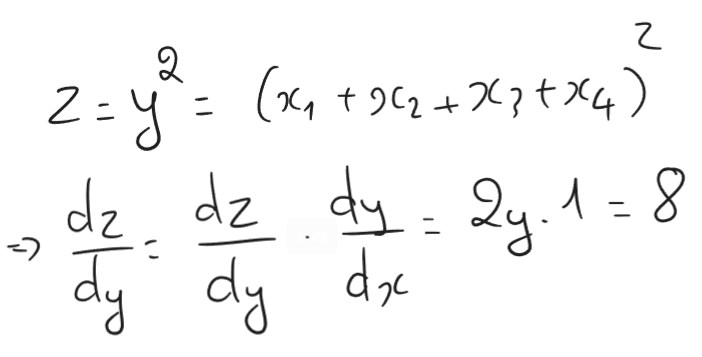

In [ ]:
import torch
from torch.autograd import Variable
import torch.optim as optim

x = torch.Tensor([[1.0, 1.0],
                  [1.0, 1.0]])
x = Variable(x, requires_grad=True)
y = x.sum()
z = y*y

# Compute gradient
optimizer = optim.SGD([x], lr=0.1)
optimizer.zero_grad()
z.backward()
optimizer.step() # x = 1 - 0.1*8

# print out
print(x)
print(x.grad)

tensor([[0.2000, 0.2000],
        [0.2000, 0.2000]], requires_grad=True)
tensor([[8., 8.],
        [8., 8.]])


In [ ]:
import torch
from torch.autograd import Variable
import torch.optim as optim

x = torch.Tensor([[1.0, 1.0],
                  [1.0, 1.0]])
x = x.requires_grad_(True)
y = x.sum()
z = y*y

# Compute gradient
optimizer = optim.SGD([x], lr=0.1)
optimizer.zero_grad()
z.backward()
optimizer.step() # x = 1 - 0.1*8

# print out
print(x)
print(x.grad)

tensor([[0.2000, 0.2000],
        [0.2000, 0.2000]], requires_grad=True)
tensor([[8., 8.],
        [8., 8.]])


# **2. Content Loss**

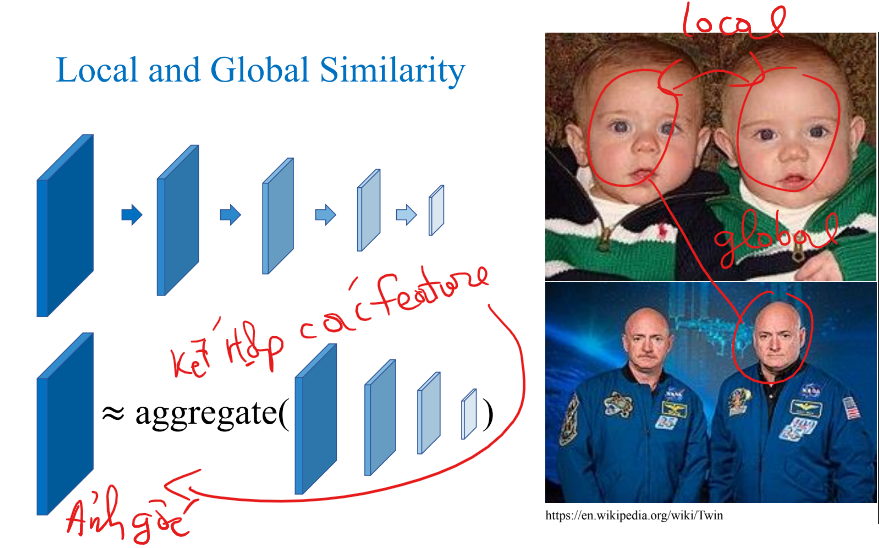

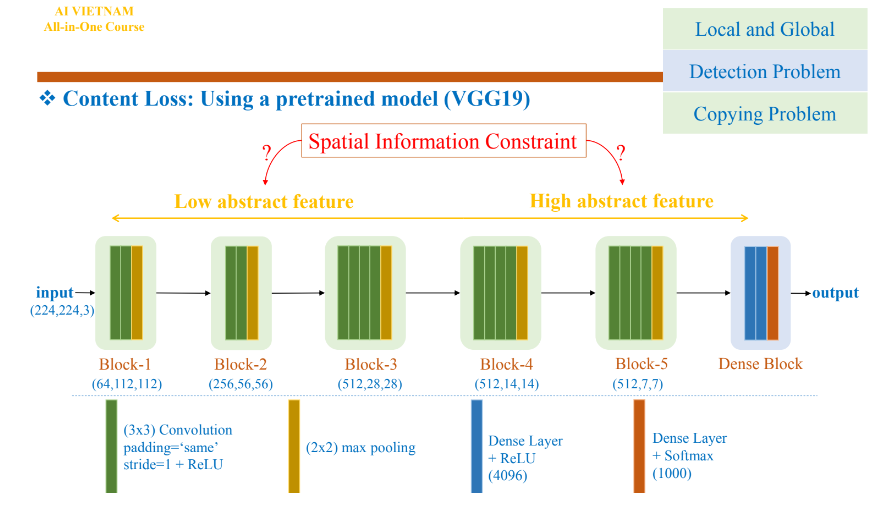

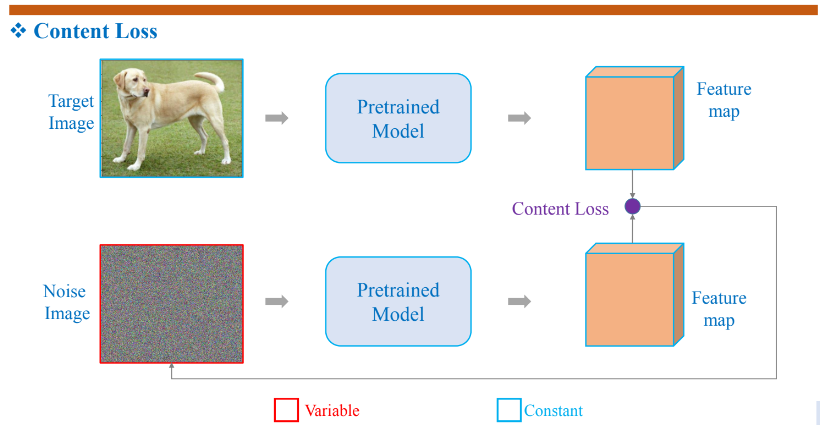

## Pretrained Model

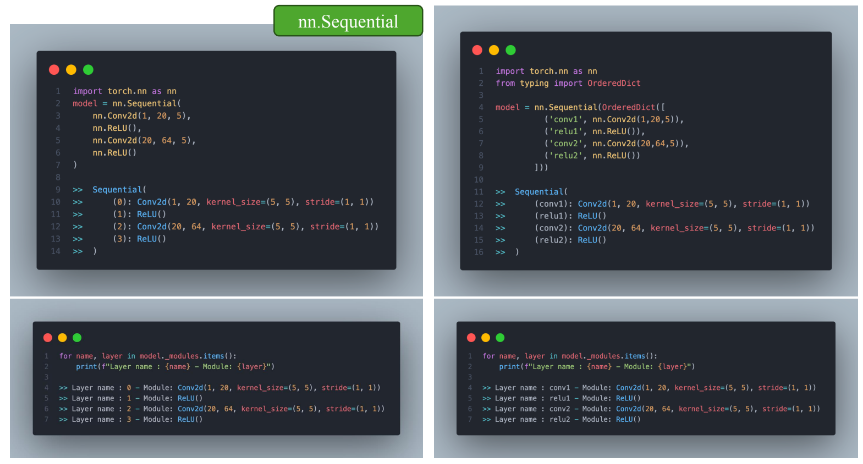

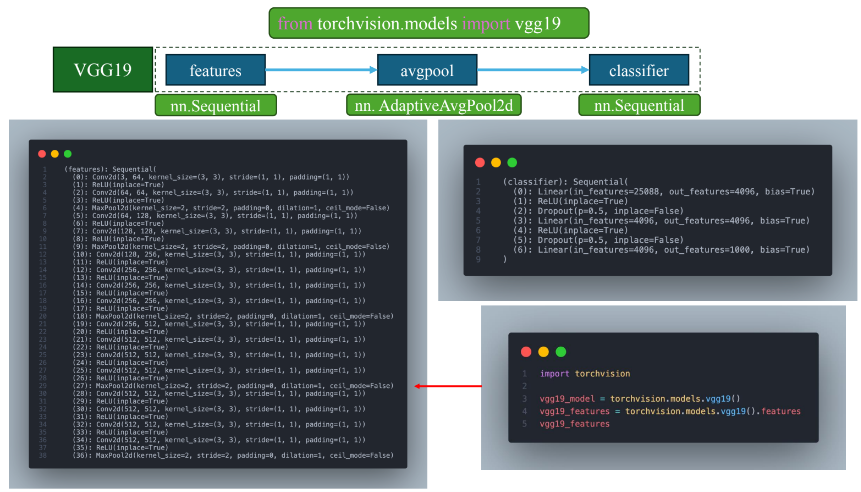

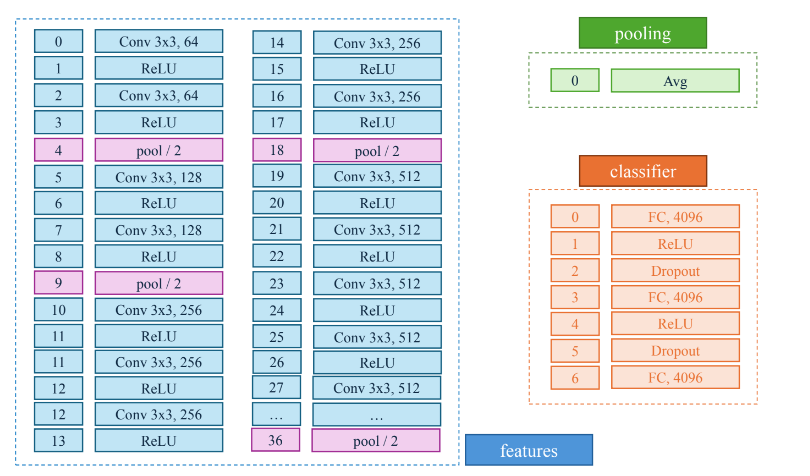

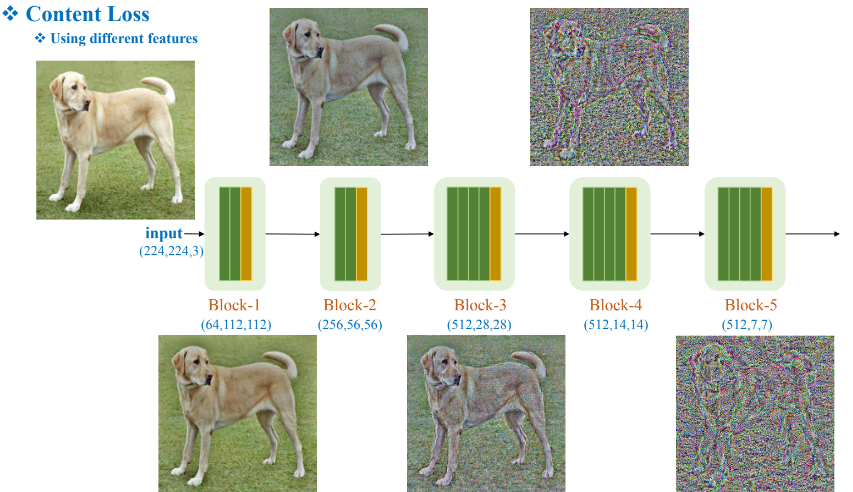

Ở các layer đầu thì thông tin local (góc cạnh) --> dễ tái tạo

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

In [ ]:
for name, pretrained_layer in VGG19_pretrained._modules.items():
    print(name)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36


In [ ]:
from PIL import Image
import torchvision.transforms as transforms
from torchvision.models import vgg19, VGG19_Weights
import torch

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image

content_img = image_loader("content_img.jpg")
VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT)
outputs = VGG19_pretrained(content_img)
print(outputs.shape)
print(torch.argmax(outputs))

torch.Size([1, 1000])
tensor(208)


In [ ]:
from PIL import Image
import torchvision.transforms as transforms
from torchvision.models import vgg19, VGG19_Weights
import torch

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image

content_img = image_loader("content_img.jpg")
VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT)
outputs = VGG19_pretrained(content_img)
print(outputs.shape)
print(torch.argmax(outputs))

torch.Size([1, 1000])
tensor(208)


In [ ]:
from PIL import Image
import torchvision.transforms as transforms
from torchvision.models import vgg19, VGG19_Weights
import torch

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image

content_img = image_loader("content_img.jpg")
VGG19_pretrained = vgg19()
outputs = VGG19_pretrained(content_img)
print(outputs.shape)
print(torch.argmax(outputs))

torch.Size([1, 1000])
tensor(375)


## Using Input - L2

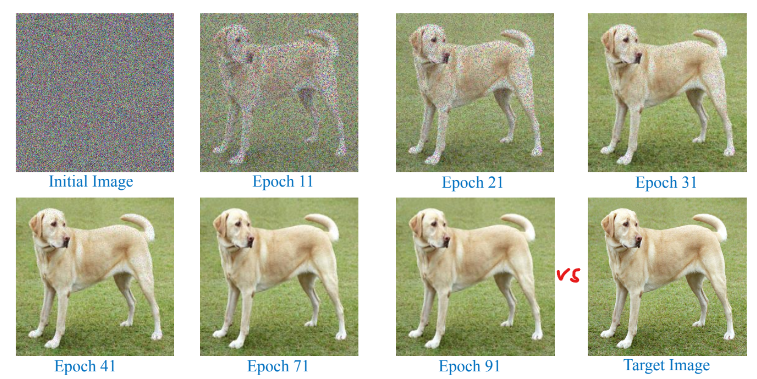

Quy về bài toán copy image

In [ ]:
%cd /content/drive/MyDrive/AIO2023/1. Main Subject/Module9_ GenerativeModels/Week 1_ Style Transfer/(4) Wednesday_ Basic Style Transfer/code_pytorch/content_loss

/content/drive/MyDrive/AIO2023/1. Main Subject/Module9_ GenerativeModels/Week 1_ Style Transfer/(4) Wednesday_ Basic Style Transfer/code_pytorch/content_loss


**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

content_img = image_loader("content_img.jpg")

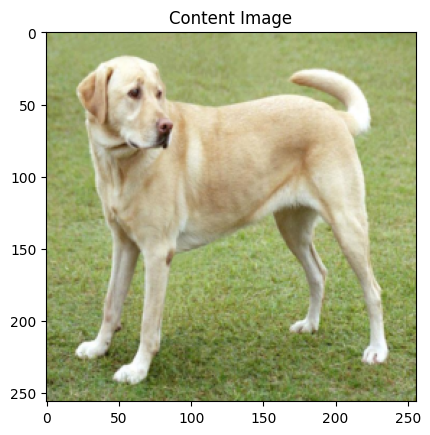

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(content_img, title='Content Image')

**Loss Functions**

In [ ]:
ContentLoss = nn.MSELoss()

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(content_img.shape).to(device)
target_img = target_img.requires_grad_(True)
optimizer = optim.Adam([target_img], lr=0.02)

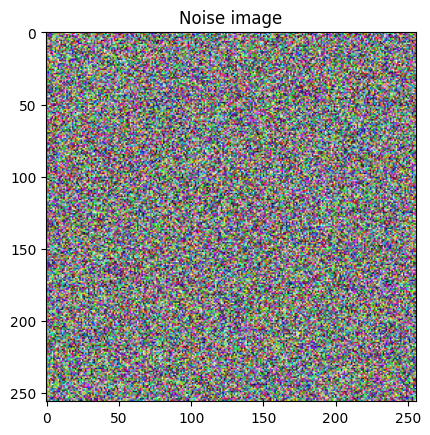

In [ ]:
imshow(target_img, title='Noise image')

In [ ]:
STEPS = 100

for step in range(STEPS):
    optimizer.zero_grad()

    content_loss = ContentLoss(content_img, target_img)
    content_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 10 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Content loss: {content_loss.item():.6f}")

        fname = '1.L2_UsingInput/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/100] Content loss: 0.121873
(256, 256, 3)
Epoch [11/100] Content loss: 0.042625
(256, 256, 3)
Epoch [21/100] Content loss: 0.012612
(256, 256, 3)
Epoch [31/100] Content loss: 0.003525
(256, 256, 3)
Epoch [41/100] Content loss: 0.001082
(256, 256, 3)
Epoch [51/100] Content loss: 0.000387
(256, 256, 3)
Epoch [61/100] Content loss: 0.000145
(256, 256, 3)
Epoch [71/100] Content loss: 0.000052
(256, 256, 3)
Epoch [81/100] Content loss: 0.000019
(256, 256, 3)
Epoch [91/100] Content loss: 0.000007
(256, 256, 3)


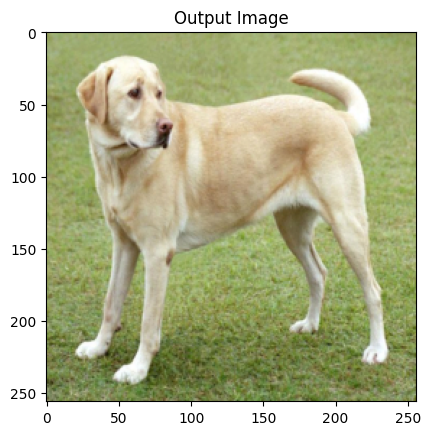

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

## Using Features - L2

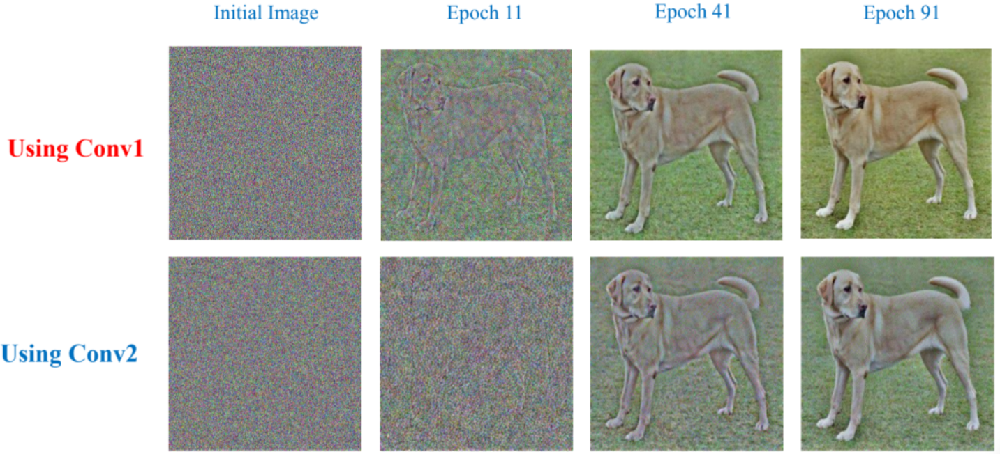
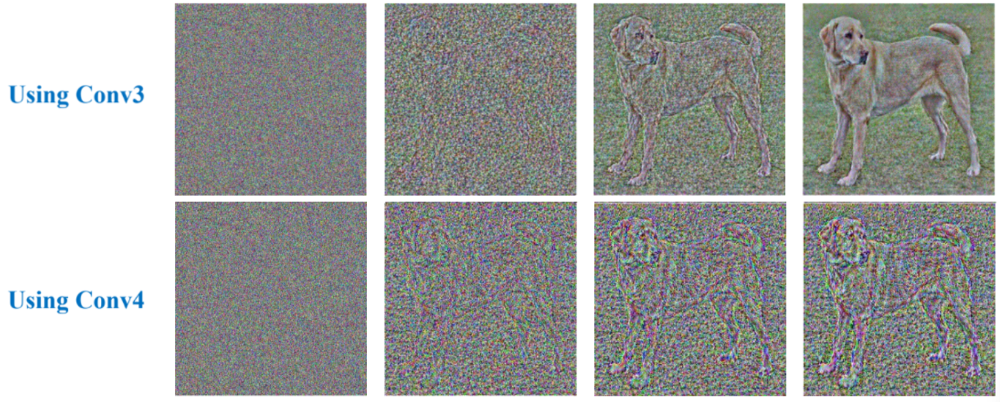

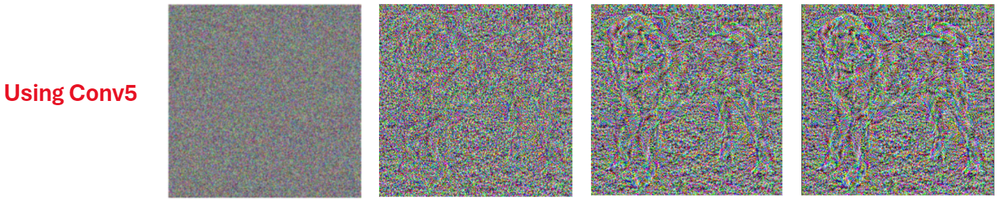

### Conv1

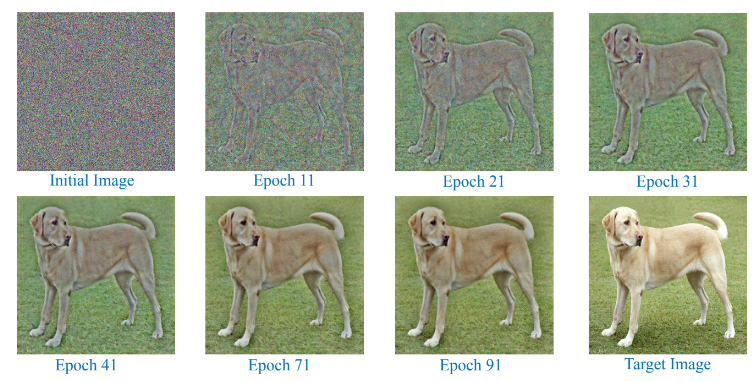

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

content_img = image_loader("content_img.jpg")

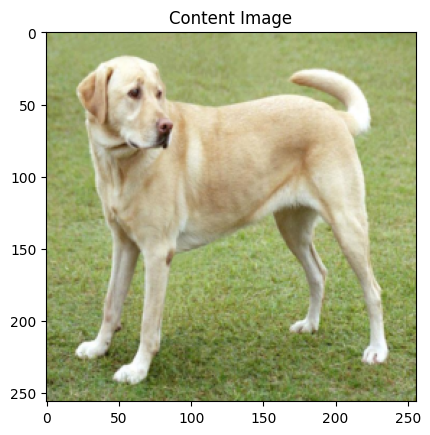

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(content_img, title='Content Image')

**Loss Functions**

In [ ]:
ContentLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:07<00:00, 81.9MB/s]


Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
content_features = get_features(VGG19_pretrained, content_img) # Tính trước

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(content_img.shape).to(device)
target_img = target_img.requires_grad_(True)
optimizer = optim.Adam([target_img], lr=0.02)

In [ ]:
STEPS = 100

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)
    content_loss = ContentLoss(content_features['conv_1'], target_features['conv_1'])
    content_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 10 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Content loss: {content_loss.item():.6f}")

        fname = '2.L2_Features_conv1/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/100] Content loss: 0.094740
(256, 256, 3)
Epoch [11/100] Content loss: 0.023199
(256, 256, 3)
Epoch [21/100] Content loss: 0.007776
(256, 256, 3)
Epoch [31/100] Content loss: 0.004128
(256, 256, 3)
Epoch [41/100] Content loss: 0.002115
(256, 256, 3)
Epoch [51/100] Content loss: 0.001258
(256, 256, 3)
Epoch [61/100] Content loss: 0.000828
(256, 256, 3)
Epoch [71/100] Content loss: 0.000592
(256, 256, 3)
Epoch [81/100] Content loss: 0.000453
(256, 256, 3)
Epoch [91/100] Content loss: 0.000367
(256, 256, 3)


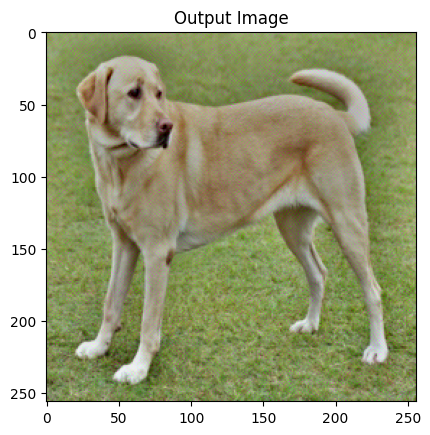

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv2

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

content_img = image_loader("content_img.jpg")

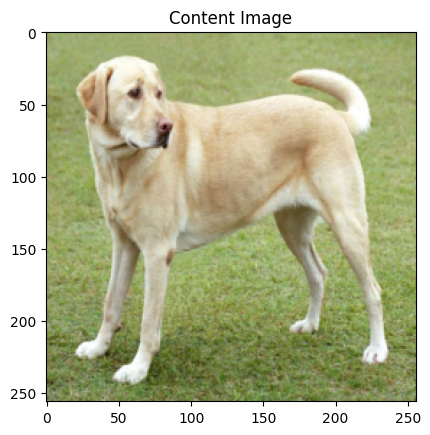

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(content_img, title='Content Image')

**Loss Functions**

In [ ]:
ContentLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
content_features = get_features(VGG19_pretrained, content_img)

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(content_img.shape).to(device)
target_img = target_img.requires_grad_(True)
optimizer = optim.Adam([target_img], lr=0.02)

In [ ]:
STEPS = 100

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)
    content_loss = ContentLoss(content_features['conv_2'], target_features['conv_2'])
    content_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 10 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Content loss: {content_loss.item():.6f}")

        fname = '3.L2_Features_conv2/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/100] Content loss: 1.847863
(256, 256, 3)
Epoch [11/100] Content loss: 0.548573
(256, 256, 3)
Epoch [21/100] Content loss: 0.241241
(256, 256, 3)
Epoch [31/100] Content loss: 0.107426
(256, 256, 3)
Epoch [41/100] Content loss: 0.056374
(256, 256, 3)
Epoch [51/100] Content loss: 0.032190
(256, 256, 3)
Epoch [61/100] Content loss: 0.020491
(256, 256, 3)
Epoch [71/100] Content loss: 0.014307
(256, 256, 3)
Epoch [81/100] Content loss: 0.010832
(256, 256, 3)
Epoch [91/100] Content loss: 0.008705
(256, 256, 3)


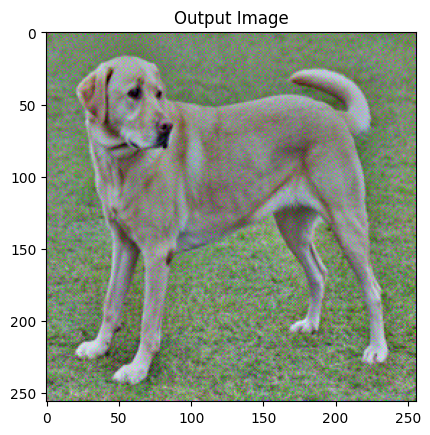

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv3

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

content_img = image_loader("content_img.jpg")

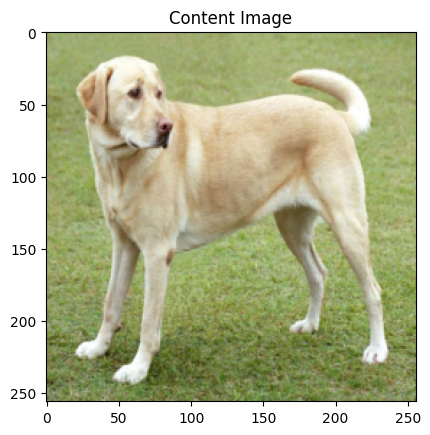

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(content_img, title='Content Image')

**Loss Functions**

In [ ]:
ContentLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
content_features = get_features(VGG19_pretrained, content_img)

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(content_img.shape).to(device)
target_img = target_img.requires_grad_(True)
optimizer = optim.Adam([target_img], lr=0.02)

In [ ]:
STEPS = 100

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)
    content_loss = ContentLoss(content_features['conv_3'], target_features['conv_3'])
    content_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 10 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Content loss: {content_loss.item():.6f}")

        fname = '4.L2_Features_conv3/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/100] Content loss: 5.400311
(256, 256, 3)
Epoch [11/100] Content loss: 1.617731
(256, 256, 3)
Epoch [21/100] Content loss: 1.072564
(256, 256, 3)
Epoch [31/100] Content loss: 0.784799
(256, 256, 3)
Epoch [41/100] Content loss: 0.598200
(256, 256, 3)
Epoch [51/100] Content loss: 0.466968
(256, 256, 3)
Epoch [61/100] Content loss: 0.369766
(256, 256, 3)
Epoch [71/100] Content loss: 0.293128
(256, 256, 3)
Epoch [81/100] Content loss: 0.229411
(256, 256, 3)
Epoch [91/100] Content loss: 0.175450
(256, 256, 3)


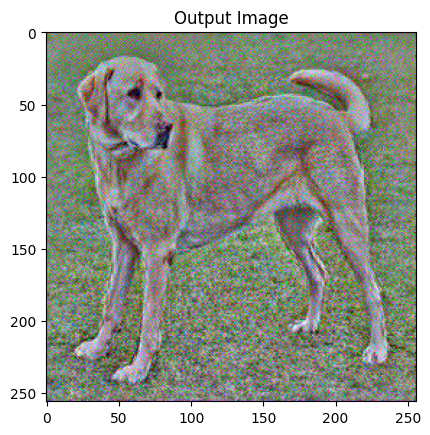

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv4

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

content_img = image_loader("content_img.jpg")

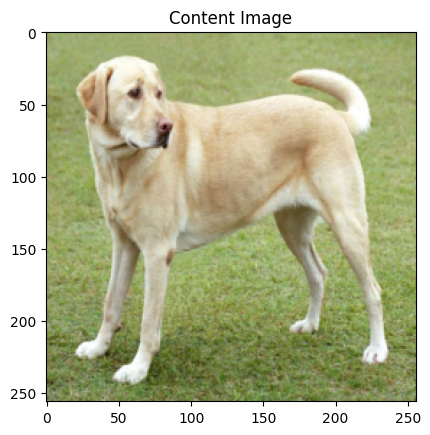

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(content_img, title='Content Image')

**Loss Functions**

In [ ]:
ContentLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
content_features = get_features(VGG19_pretrained, content_img)

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(content_img.shape).to(device)
target_img = target_img.requires_grad_(True)
optimizer = optim.Adam([target_img], lr=0.02)

In [ ]:
STEPS = 100

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)
    content_loss = ContentLoss(content_features['conv_4'], target_features['conv_4'])
    content_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 10 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Content loss: {content_loss.item():.6f}")

        fname = '5.L2_Features_conv4/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/100] Content loss: 3.951166
(256, 256, 3)
Epoch [11/100] Content loss: 1.914843
(256, 256, 3)
Epoch [21/100] Content loss: 1.161218
(256, 256, 3)
Epoch [31/100] Content loss: 0.803611
(256, 256, 3)
Epoch [41/100] Content loss: 0.585569
(256, 256, 3)
Epoch [51/100] Content loss: 0.447247
(256, 256, 3)
Epoch [61/100] Content loss: 0.357079
(256, 256, 3)
Epoch [71/100] Content loss: 0.294937
(256, 256, 3)
Epoch [81/100] Content loss: 0.249888
(256, 256, 3)
Epoch [91/100] Content loss: 0.215007
(256, 256, 3)


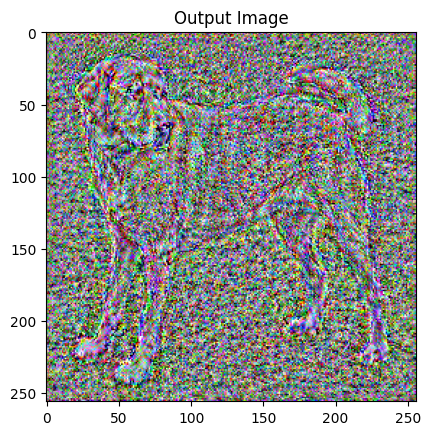

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv5

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

content_img = image_loader("content_img.jpg")

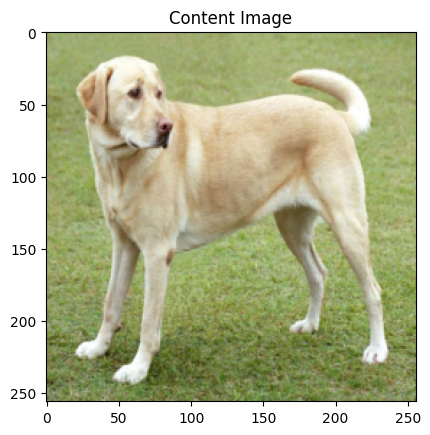

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(content_img, title='Content Image')

**Loss Functions**

In [ ]:
ContentLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
content_features = get_features(VGG19_pretrained, content_img)

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(content_img.shape).to(device)
target_img = target_img.requires_grad_(True)
optimizer = optim.Adam([target_img], lr=0.02)

In [ ]:
STEPS = 100

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)
    content_loss = ContentLoss(content_features['conv_5'], target_features['conv_5'])
    content_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 10 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Content loss: {content_loss.item():.6f}")

        fname = '6.L2_Features_conv5/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/100] Content loss: 2.091914
(256, 256, 3)
Epoch [11/100] Content loss: 0.918636
(256, 256, 3)
Epoch [21/100] Content loss: 0.414207
(256, 256, 3)
Epoch [31/100] Content loss: 0.227221
(256, 256, 3)
Epoch [41/100] Content loss: 0.146046
(256, 256, 3)
Epoch [51/100] Content loss: 0.104933
(256, 256, 3)
Epoch [61/100] Content loss: 0.081169
(256, 256, 3)
Epoch [71/100] Content loss: 0.065791
(256, 256, 3)
Epoch [81/100] Content loss: 0.054961
(256, 256, 3)
Epoch [91/100] Content loss: 0.047890
(256, 256, 3)


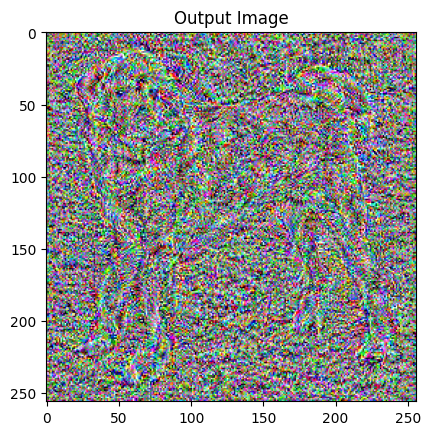

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

## Others

### Conv1 - L1

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

content_img = image_loader("content_img.jpg")

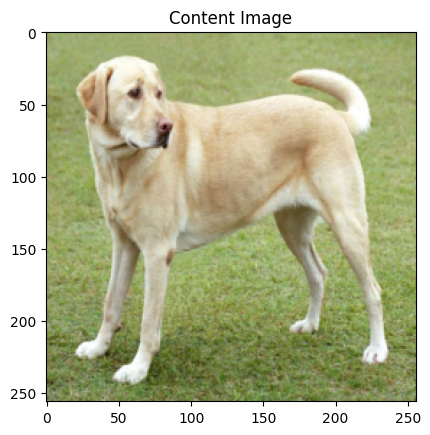

In [ ]:
unloader = transforms.ToPILImage()

def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = unloader(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)


plt.figure()
imshow(content_img, title='Content Image')

**Loss Functions**

In [ ]:
ContentLoss = nn.L1Loss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
content_features = get_features(VGG19_pretrained, content_img)

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(content_img.shape).to(device)
target_img = target_img.requires_grad_(True)
optimizer = optim.Adam([target_img], lr=0.02)

In [ ]:
STEPS = 100

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)
    content_loss = ContentLoss(content_features['conv_1'], target_features['conv_1'])
    content_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 10 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Content loss: {content_loss.item():.6f}")

        fname = '7.L1_conv1/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/100] Content loss: 0.192244
(256, 256, 3)
Epoch [11/100] Content loss: 0.090665
(256, 256, 3)
Epoch [21/100] Content loss: 0.046076
(256, 256, 3)
Epoch [31/100] Content loss: 0.028431
(256, 256, 3)
Epoch [41/100] Content loss: 0.017742
(256, 256, 3)
Epoch [51/100] Content loss: 0.011640
(256, 256, 3)
Epoch [61/100] Content loss: 0.008071
(256, 256, 3)
Epoch [71/100] Content loss: 0.005814
(256, 256, 3)
Epoch [81/100] Content loss: 0.004519
(256, 256, 3)
Epoch [91/100] Content loss: 0.003805
(256, 256, 3)


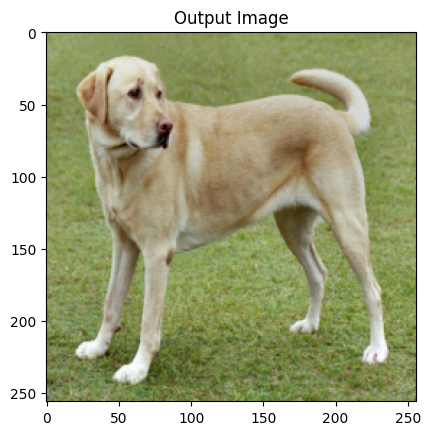

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv1 - Cosine

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

content_img = image_loader("content_img.jpg")

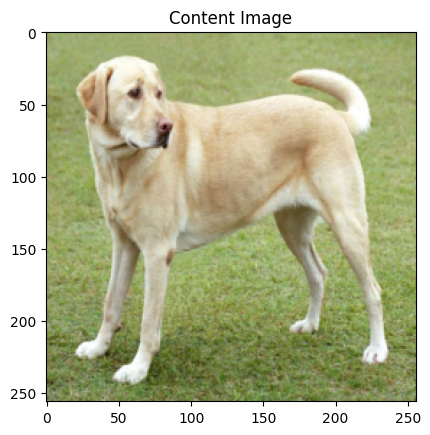

In [ ]:
unloader = transforms.ToPILImage()

def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = unloader(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)


plt.figure()
imshow(content_img, title='Content Image')

**Content Loss**

In [ ]:
ContentLoss = nn.CosineSimilarity()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()

for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
content_features = get_features(VGG19_pretrained, content_img)

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(content_img.shape).to(device)
target_img = target_img.requires_grad_(True)
optimizer = optim.Adam([target_img], lr=0.02)

In [ ]:
STEPS = 100

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)

    content_loss = 1.0 - ContentLoss(content_features['conv_1'], target_features['conv_1']).mean()
    content_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 10 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Content loss: {content_loss.item():.6f}")

        fname = '8.Cosine_conv1/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/100] Content loss: 0.280154
(256, 256, 3)
Epoch [11/100] Content loss: 0.113856
(256, 256, 3)
Epoch [21/100] Content loss: 0.039427
(256, 256, 3)
Epoch [31/100] Content loss: 0.018267
(256, 256, 3)
Epoch [41/100] Content loss: 0.008278
(256, 256, 3)
Epoch [51/100] Content loss: 0.004416
(256, 256, 3)
Epoch [61/100] Content loss: 0.002710
(256, 256, 3)
Epoch [71/100] Content loss: 0.001898
(256, 256, 3)
Epoch [81/100] Content loss: 0.001462
(256, 256, 3)
Epoch [91/100] Content loss: 0.001197
(256, 256, 3)


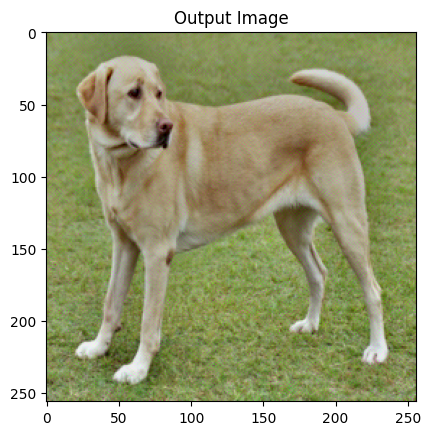

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Random Net - Conv1 - L2

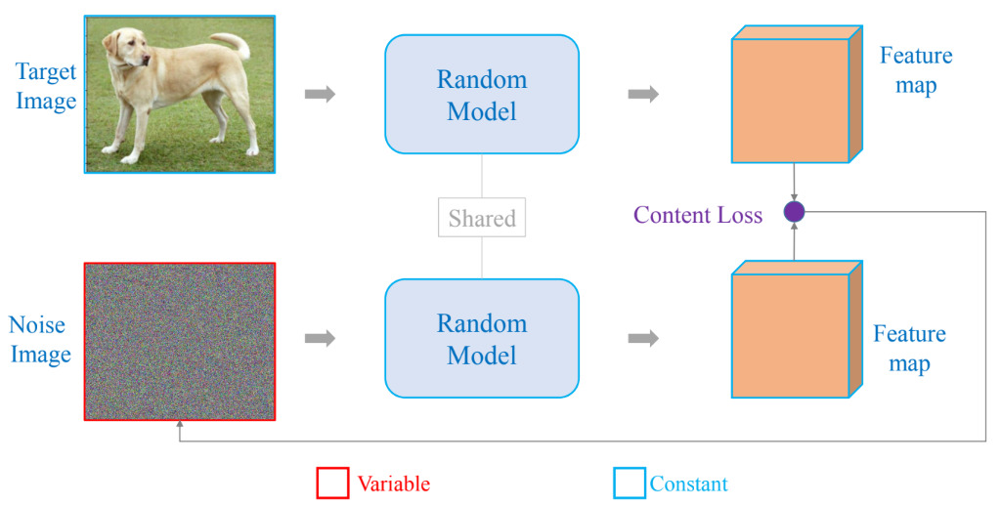

Random net vẫn hoạt động tốt vì:
- random model có thể hiểu là 1 phép ánh xạ cố định
- Target Image --> a
- Noise Image --> b
- không cần kiến thức, Chỉ đi tối ưu hàm Loss Điều chỉnh lại Noise Image sao cho khi ánh xạ sẽ thành a (giống với Target Image)

Dù là pretrained model hay rand model thì mục tiêu vẫn là tối ưu hàm loss. Khi mà hội tụ thì vẫn tốt như nhau.



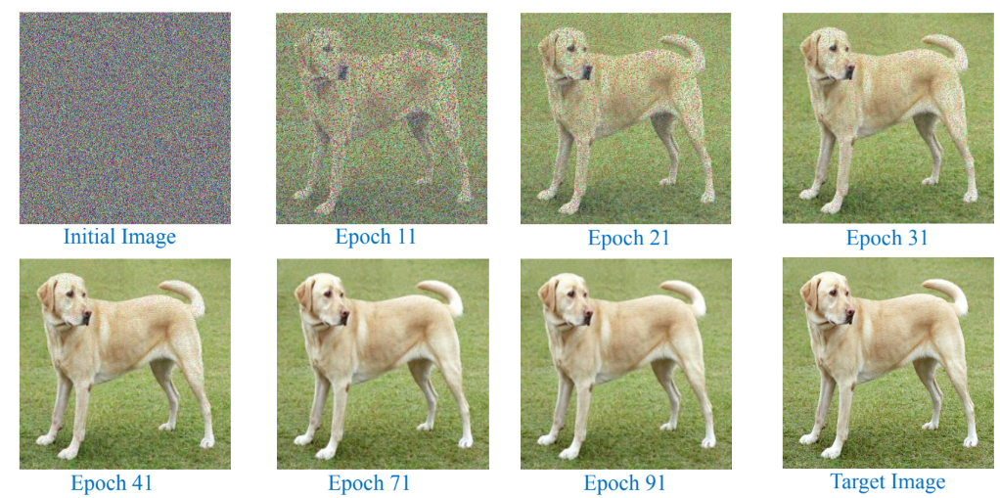

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

content_img = image_loader("content_img.jpg")

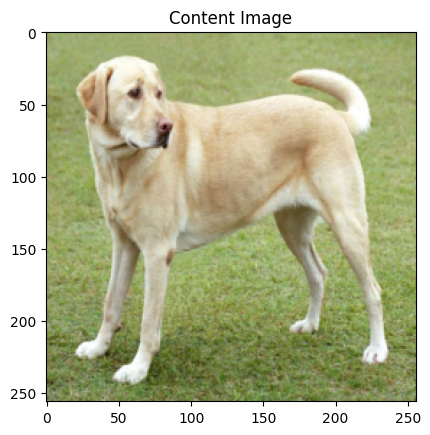

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(content_img, title='Content Image')

**Loss Functions**

In [ ]:
ContentLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19

VGG19_pretrained = vgg19().features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
content_features = get_features(VGG19_pretrained, content_img)

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(content_img.shape).to(device)
target_img = target_img.requires_grad_(True)
optimizer = optim.Adam([target_img], lr=0.02)

In [ ]:
STEPS = 100

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)
    content_loss = ContentLoss(content_features['conv_1'], target_features['conv_1'])
    content_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 10 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Content loss: {content_loss.item():.6f}")

        fname = '9.L2_Features_RandNet/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/100] Content loss: 0.005206
(256, 256, 3)
Epoch [11/100] Content loss: 0.001994
(256, 256, 3)
Epoch [21/100] Content loss: 0.000641
(256, 256, 3)
Epoch [31/100] Content loss: 0.000195
(256, 256, 3)
Epoch [41/100] Content loss: 0.000061
(256, 256, 3)
Epoch [51/100] Content loss: 0.000020
(256, 256, 3)
Epoch [61/100] Content loss: 0.000007
(256, 256, 3)
Epoch [71/100] Content loss: 0.000003
(256, 256, 3)
Epoch [81/100] Content loss: 0.000001
(256, 256, 3)
Epoch [91/100] Content loss: 0.000000
(256, 256, 3)


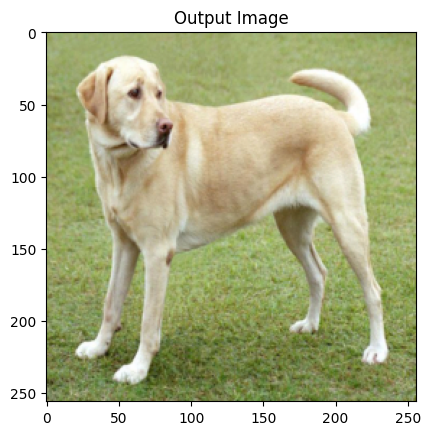

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Two Content Images - L2

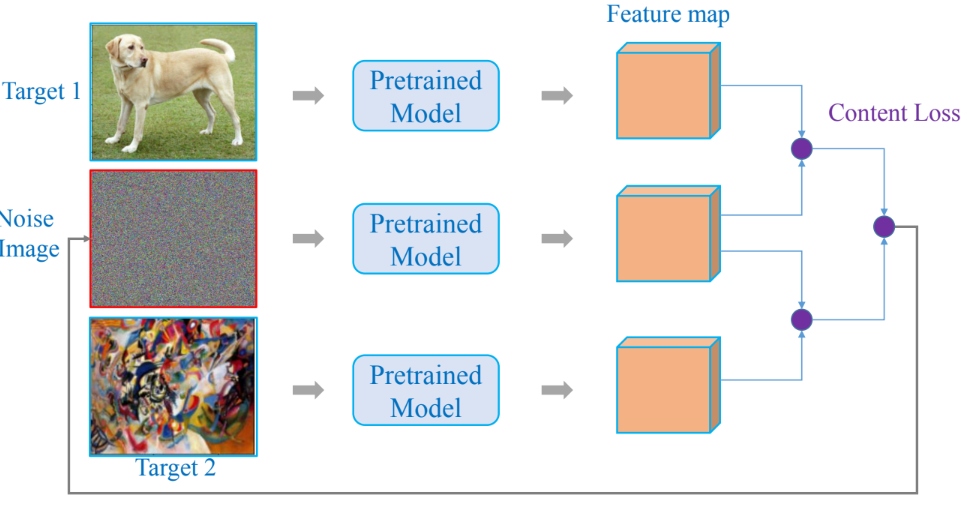

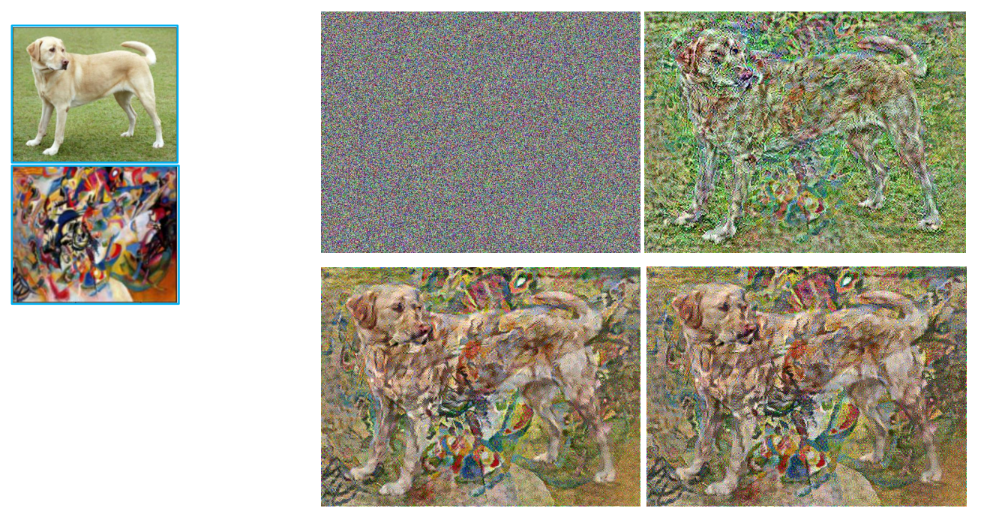

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

content_img_1 = image_loader("/content/drive/MyDrive/AIO2023/1. Main Subject/Module9_ GenerativeModels/Week 1_ Style Transfer/(4) Wednesday_ Basic Style Transfer/code_pytorch/content_loss/content_img.jpg")
content_img_2 = image_loader("/content/drive/MyDrive/AIO2023/1. Main Subject/Module9_ GenerativeModels/Week 1_ Style Transfer/(4) Wednesday_ Basic Style Transfer/code_pytorch/style_loss/style_img.jpg")

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)

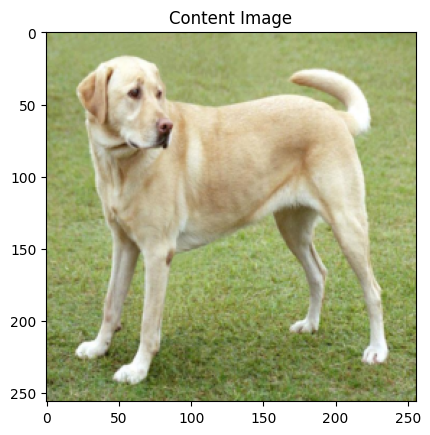

In [ ]:
plt.figure()
imshow(content_img_1, title='Content Image')

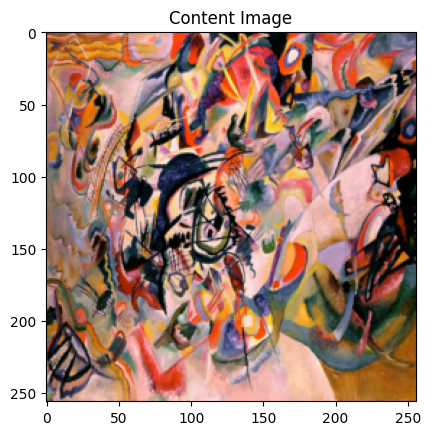

In [ ]:
plt.figure()
imshow(content_img_2, title='Content Image')

**Loss Functions**

In [ ]:
ContentLoss = nn.MSELoss()

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(content_img_1.shape).to(device)
target_img = target_img.requires_grad_(True)
optimizer = optim.Adam([target_img], lr=0.02)

In [ ]:
STEPS = 100

for step in range(STEPS):
    optimizer.zero_grad()

    content_loss_1 = ContentLoss(content_img_1, target_img)
    content_loss_2 = ContentLoss(content_img_2, target_img)
    content_loss = content_loss_1 + content_loss_2

    content_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 10 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Content loss: {content_loss.item():.6f}")

        fname = '9.TwoContentImages/at_%d.png' % (step+1)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/100] Content loss: 0.276337
Epoch [11/100] Content loss: 0.125765
Epoch [21/100] Content loss: 0.072378
Epoch [31/100] Content loss: 0.058050
Epoch [41/100] Content loss: 0.054635
Epoch [51/100] Content loss: 0.053637
Epoch [61/100] Content loss: 0.053246
Epoch [71/100] Content loss: 0.053084
Epoch [81/100] Content loss: 0.053023
Epoch [91/100] Content loss: 0.053001


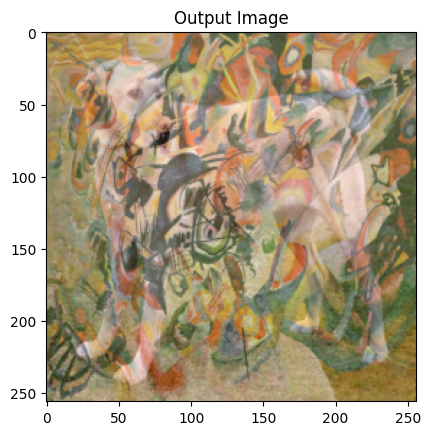

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

# **3. Style Loss**

## Vector Operations

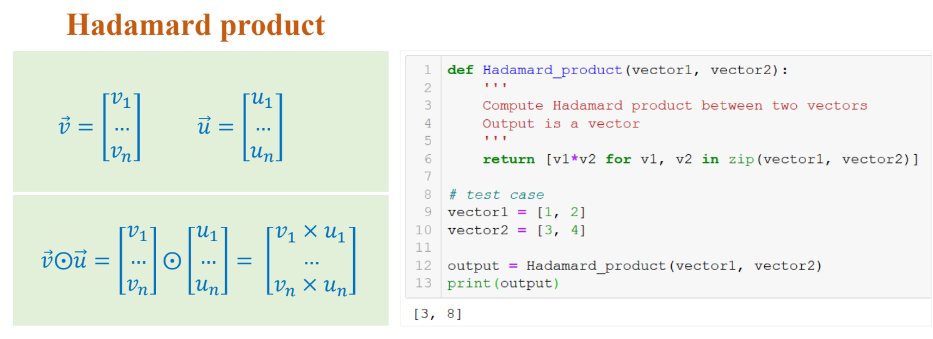

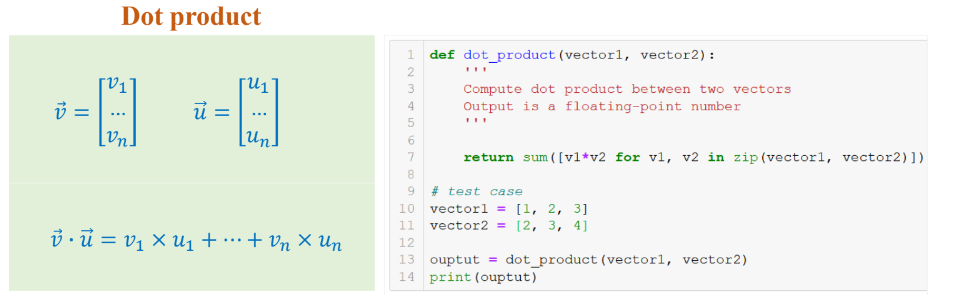

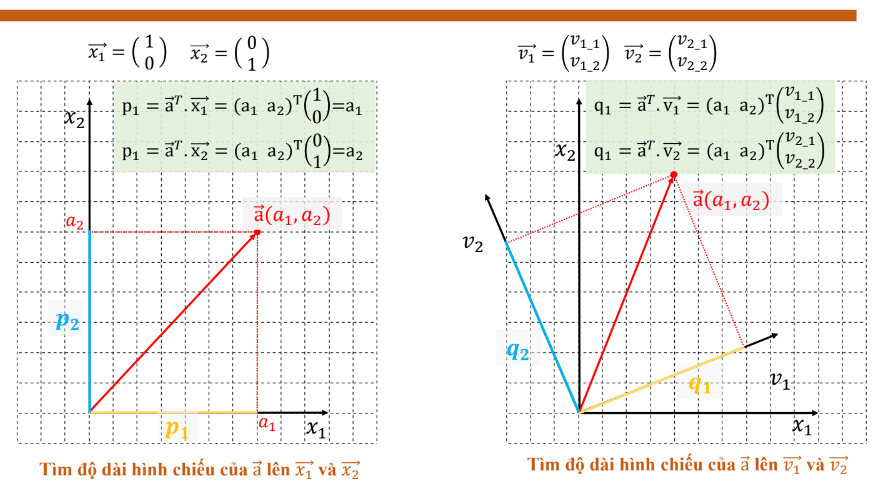

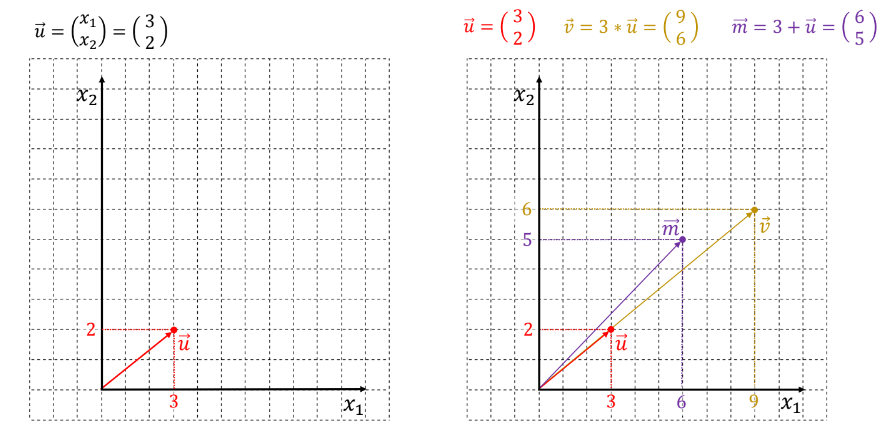

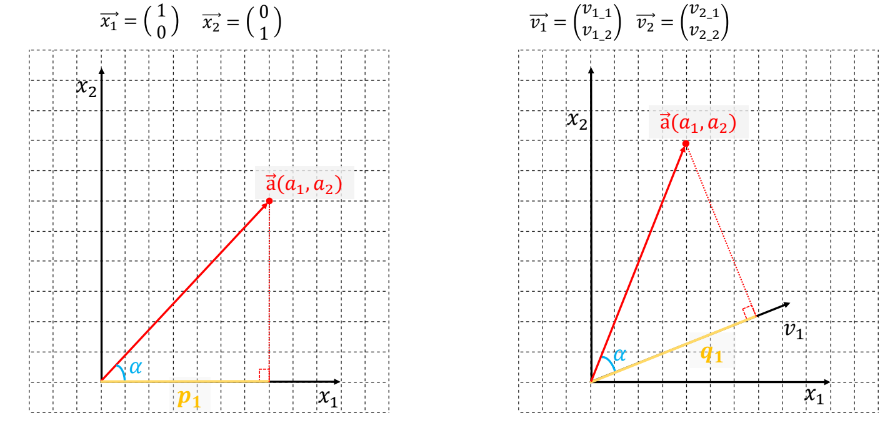

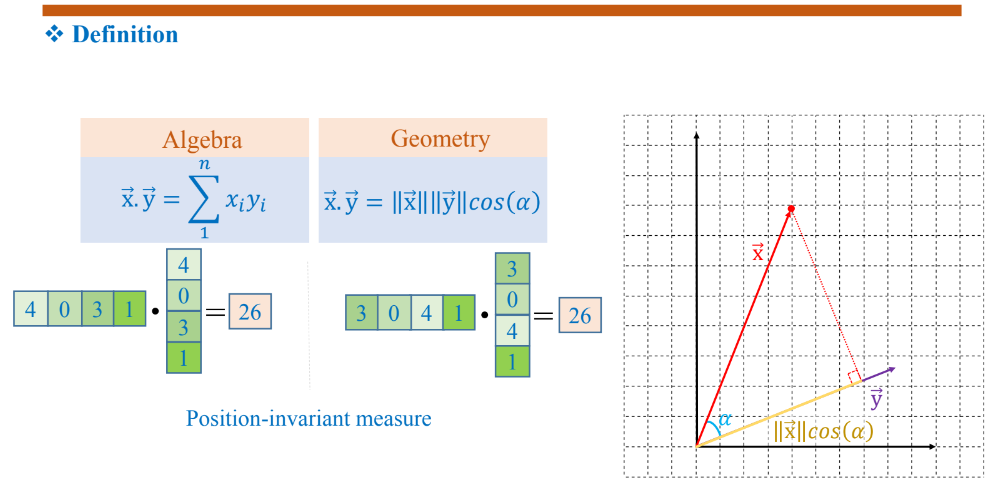

In [ ]:
import numpy as np

u = np.array([0, 5])
v = np.array([3, 3])

dproduct_1 = np.dot(u,v)
dproduct_2 = np.dot(v,u)

print(dproduct_1)
print(dproduct_2)

15
15


In [ ]:
# Geometry
norm_u = np.linalg.norm(u)
norm_v = np.linalg.norm(v)

alpha = 3.14/4 # 45 degree
dproduct_3 = np.cos(alpha)*norm_u*norm_v
print(dproduct_3)

15.00597126179825


### Gram Matrix

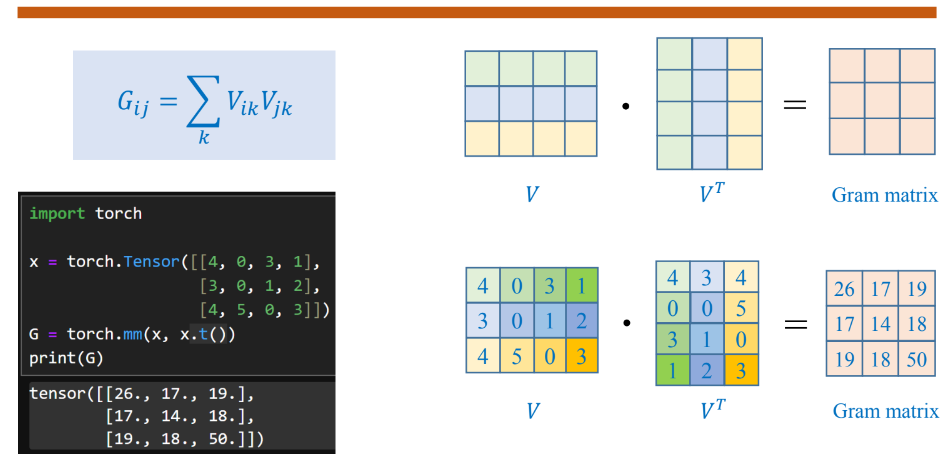

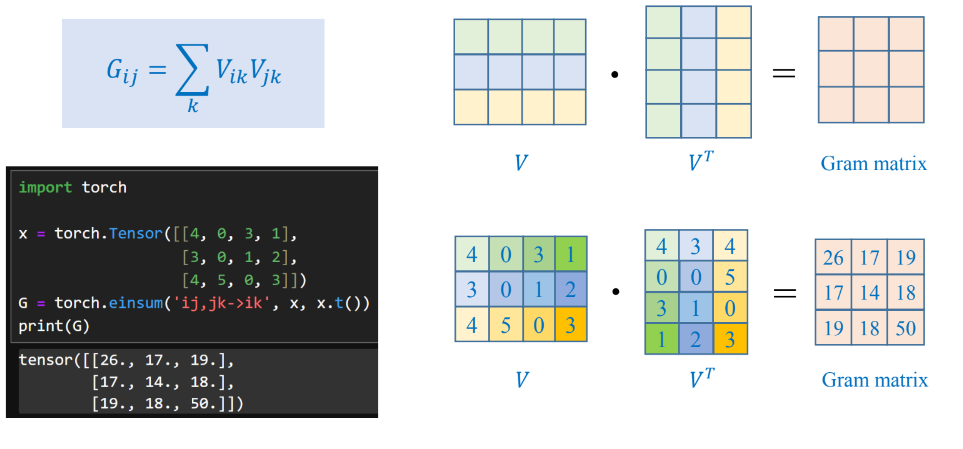

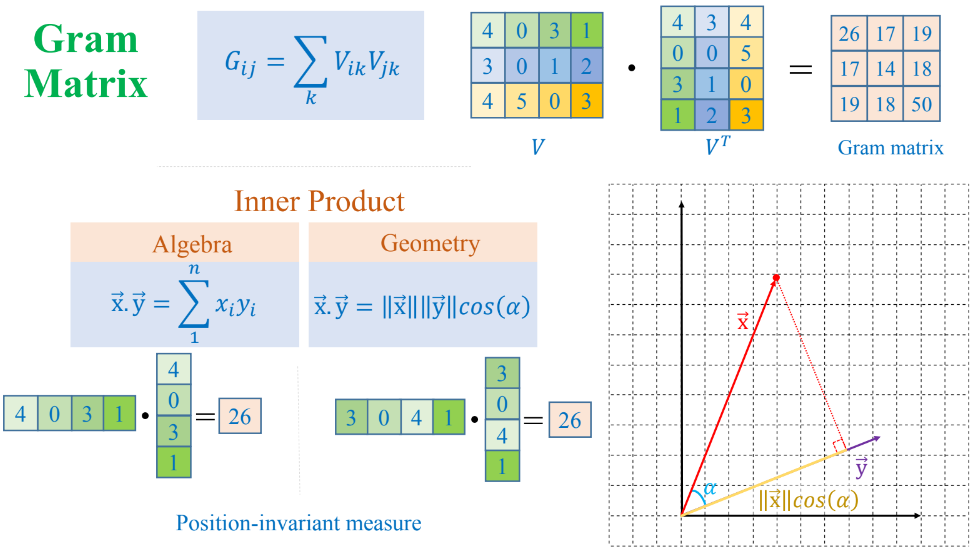

**Tính chất Self-Description**:

Gram Matrix thể hiện mối tương quan giữa các kênh màu trong một feature map. Do đó, nó có thể được sử dụng để mô tả phong cách hình ảnh một cách độc lập với nội dung hình ảnh.

Ví dụ, hai hình ảnh có nội dung khác nhau nhưng có cùng phong cách sẽ có Gram Matrix tương tự nhau.

**Tính chất Position-Invariant Measure**:

Gram Matrix không phụ thuộc vào vị trí của các pixel trong hình ảnh. Điều này có nghĩa là nó có thể được sử dụng để mô tả phong cách hình ảnh một cách tổng thể, bất kể các chi tiết cụ thể của hình ảnh.

Ví dụ, hai hình ảnh có cùng phong cách nhưng được chụp từ các góc độ khác nhau sẽ có Gram Matrix tương tự nhau.

**Lợi ích của hai tính chất này**:

Tính linh hoạt: Gram Matrix có thể được sử dụng với nhiều loại hình ảnh khác nhau, bất kể nội dung hay vị trí của các pixel.
Khả năng khái quát: Gram Matrix có thể mô tả phong cách hình ảnh một cách tổng thể, giúp cho việc chuyển đổi phong cách trở nên hiệu quả hơn.
Ví dụ:

Giả sử bạn có một bức ảnh phong cảnh (content image) và một bức ảnh tranh trừu tượng (style image). Sử dụng Gram Matrix, bạn có thể chuyển đổi phong cách của bức ảnh phong cảnh sang phong cách của bức ảnh tranh trừu tượng, nhưng vẫn giữ nguyên nội dung ban đầu của bức ảnh phong cảnh.

**Tóm lại**:

Gram Matrix là một công cụ mạnh mẽ và linh hoạt để chuyển đổi phong cách hình ảnh. Nó có tính chất self-description và position-invariant measure, giúp cho việc mô tả và chuyển đổi phong cách hình ảnh trở nên hiệu quả hơn.

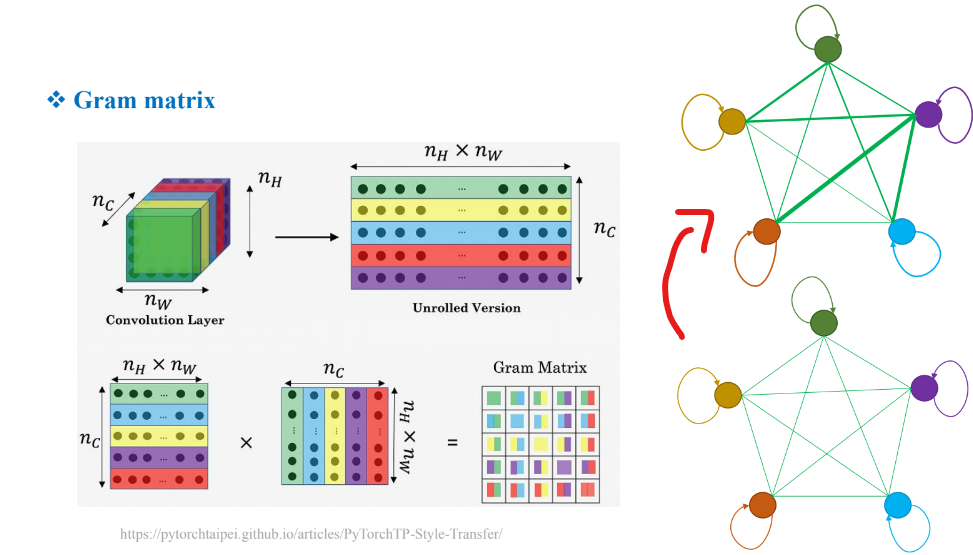

### Visualize

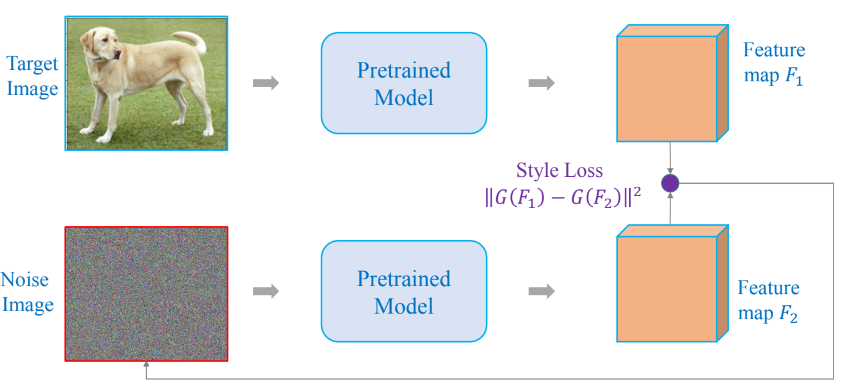

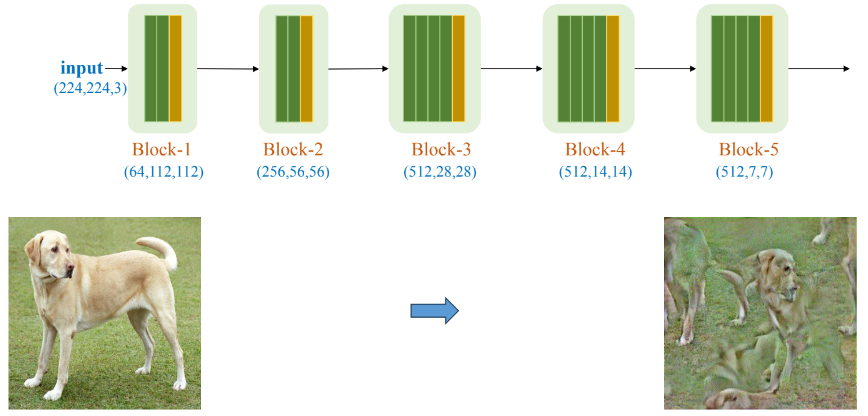

2 bức ảnh này nhìn có thể khác nhau nhưng chỉ khác nhau về vị trí các feature --> xét đến tính chất invariant position của gram matrix thì g(f) của cả 2 đều tương đồng nhau

- Gram matrix tính toán tích chập nội của các kênh màu trong một feature map, tạo ra ma trận vuông thể hiện mối tương quan giữa các kênh.
- Tính chất invariant position của Gram matrix nghĩa là nó không phụ thuộc vào vị trí của các pixel trong hình ảnh.
- Do đó, hai bức ảnh có cùng phong cách nhưng được chụp từ các góc độ khác nhau hoặc có vị trí các feature khác nhau sẽ có Gram matrix tương tự nhau.

## Using Features

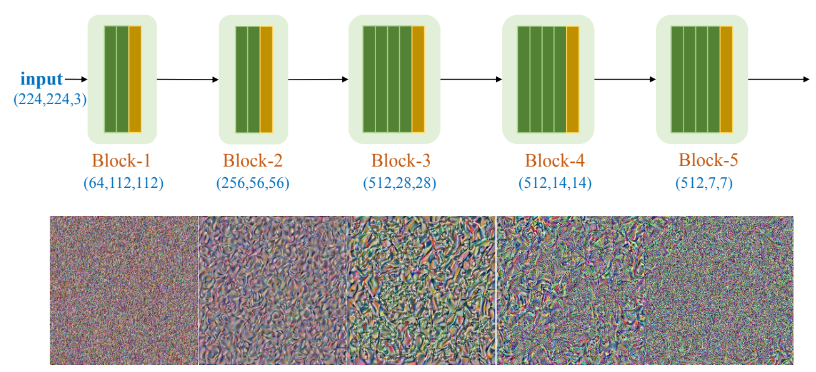

### Conv1 - L2

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

style_img = image_loader("style_img.jpg")

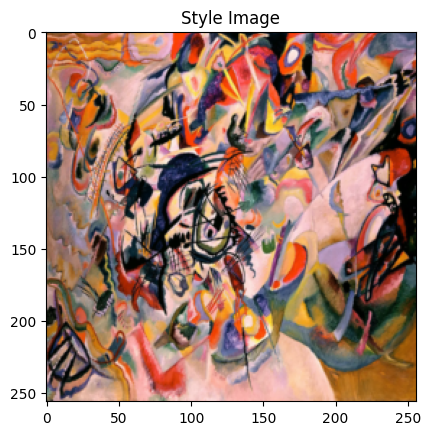

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(style_img, title='Style Image')

**Loss Functions**

In [ ]:
def gram_matrix(tensor):
    a, b, c, d = tensor.size()
    tensor = tensor.view(a * b, c * d)
    G = torch.mm(tensor, tensor.t())
    return G.div(a * b * c * d)

StyleLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
style_features = get_features(VGG19_pretrained, style_img)

**Training**

In [ ]:
style_layers = ['conv_1']

In [ ]:
import torch.optim as optim

target_img = torch.rand(style_img.shape).to(device)
target_img = target_img.requires_grad_(True)

optimizer = optim.Adam([target_img], lr=0.1)

In [ ]:
STEPS = 1000

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)

    style_loss = 0
    for layer in style_layers:
        target_gram = gram_matrix(target_features[layer])
        style_gram = gram_matrix(style_features[layer])
        style_loss += StyleLoss(style_gram, target_gram)

    style_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 100 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Style loss: {style_loss.item():.8f}")

        fname = '1.Conv1/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/1000] Style loss: 0.00000022
(256, 256, 3)
Epoch [101/1000] Style loss: 0.00000014
(256, 256, 3)
Epoch [201/1000] Style loss: 0.00000010
(256, 256, 3)
Epoch [301/1000] Style loss: 0.00000008
(256, 256, 3)
Epoch [401/1000] Style loss: 0.00000007
(256, 256, 3)
Epoch [501/1000] Style loss: 0.00000006
(256, 256, 3)
Epoch [601/1000] Style loss: 0.00000005
(256, 256, 3)
Epoch [701/1000] Style loss: 0.00000005
(256, 256, 3)
Epoch [801/1000] Style loss: 0.00000004
(256, 256, 3)
Epoch [901/1000] Style loss: 0.00000004
(256, 256, 3)


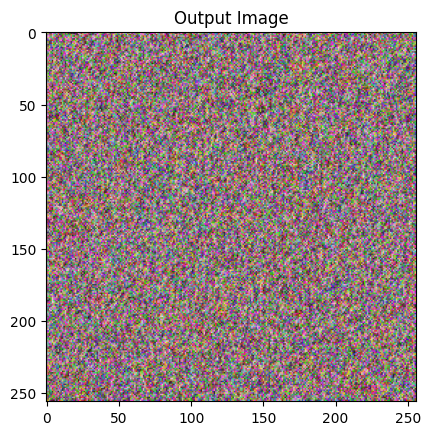

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv2 - L2

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

style_img = image_loader("style_img.jpg")

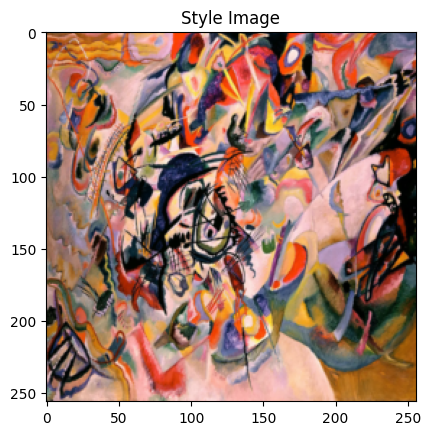

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(style_img, title='Style Image')

**Loss Functions**

In [ ]:
def gram_matrix(tensor):
    a, b, c, d = tensor.size()
    tensor = tensor.view(a * b, c * d)
    G = torch.mm(tensor, tensor.t())
    return G.div(a * b * c * d)

StyleLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
style_features = get_features(VGG19_pretrained, style_img)

In [ ]:
style_layers = ['conv_2']

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(style_img.shape).to(device)
target_img = target_img.requires_grad_(True)

optimizer = optim.Adam([target_img], lr=0.1)

In [ ]:
STEPS = 1000

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)

    style_loss = 0
    for layer in style_layers:
        target_gram = gram_matrix(target_features[layer])
        style_gram = gram_matrix(style_features[layer])
        style_loss += StyleLoss(style_gram, target_gram)

    style_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 100 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Style loss: {style_loss.item():.8f}")

        fname = '2.Conv2/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/1000] Style loss: 0.00004472
(256, 256, 3)
Epoch [101/1000] Style loss: 0.00000028
(256, 256, 3)
Epoch [201/1000] Style loss: 0.00000013
(256, 256, 3)
Epoch [301/1000] Style loss: 0.00000009
(256, 256, 3)
Epoch [401/1000] Style loss: 0.00000007
(256, 256, 3)
Epoch [501/1000] Style loss: 0.00000005
(256, 256, 3)
Epoch [601/1000] Style loss: 0.00000004
(256, 256, 3)
Epoch [701/1000] Style loss: 0.00000003
(256, 256, 3)
Epoch [801/1000] Style loss: 0.00000003
(256, 256, 3)
Epoch [901/1000] Style loss: 0.00000003
(256, 256, 3)


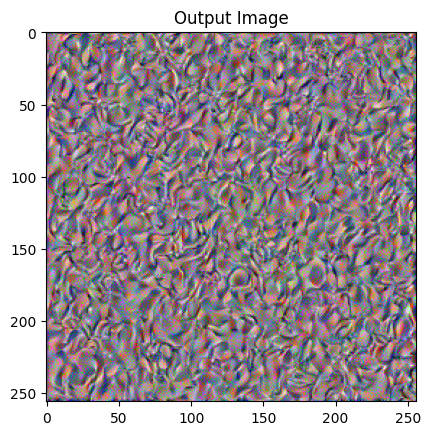

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv3 - L2

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

style_img = image_loader("style_img.jpg")

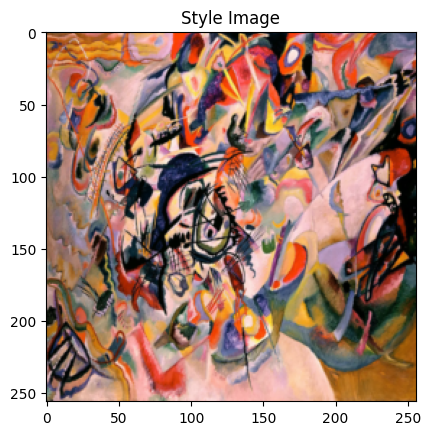

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(style_img, title='Style Image')

**Loss** Functions

In [ ]:
def gram_matrix(tensor):
    a, b, c, d = tensor.size()
    tensor = tensor.view(a * b, c * d)
    G = torch.mm(tensor, tensor.t())
    return G.div(a * b * c * d)

StyleLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
style_features = get_features(VGG19_pretrained, style_img)

In [ ]:
style_layers = ['conv_3']

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(style_img.shape).to(device)
target_img = target_img.requires_grad_(True)

optimizer = optim.Adam([target_img], lr=0.1)

In [ ]:
STEPS = 1000

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)

    style_loss = 0
    for layer in style_layers:
        target_gram = gram_matrix(target_features[layer])
        style_gram = gram_matrix(style_features[layer])
        style_loss += StyleLoss(style_gram, target_gram)

    style_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 100 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Style loss: {style_loss.item():.8f}")

        fname = '3.Conv3/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/1000] Style loss: 0.00018821
(256, 256, 3)
Epoch [101/1000] Style loss: 0.00000088
(256, 256, 3)
Epoch [201/1000] Style loss: 0.00000035
(256, 256, 3)
Epoch [301/1000] Style loss: 0.00000021
(256, 256, 3)
Epoch [401/1000] Style loss: 0.00000015
(256, 256, 3)
Epoch [501/1000] Style loss: 0.00000012
(256, 256, 3)
Epoch [601/1000] Style loss: 0.00000010
(256, 256, 3)
Epoch [701/1000] Style loss: 0.00000008
(256, 256, 3)
Epoch [801/1000] Style loss: 0.00000007
(256, 256, 3)
Epoch [901/1000] Style loss: 0.00000006
(256, 256, 3)


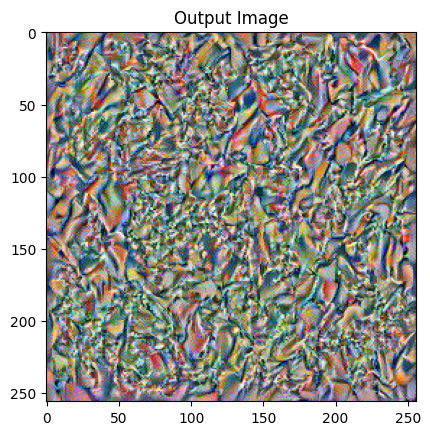

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv4 - L2

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

style_img = image_loader("style_img.jpg")

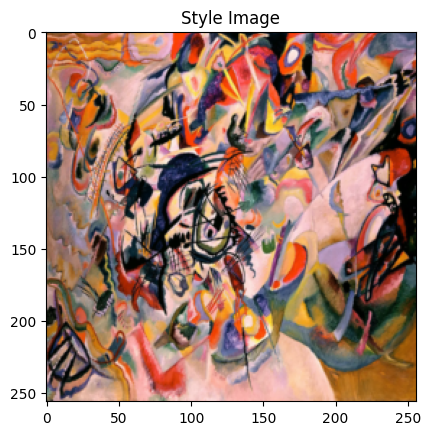

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(style_img, title='Style Image')

**Loss Functions**

In [ ]:
def gram_matrix(tensor):
    a, b, c, d = tensor.size()
    tensor = tensor.view(a * b, c * d)
    G = torch.mm(tensor, tensor.t())
    return G.div(a * b * c * d)

StyleLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
style_features = get_features(VGG19_pretrained, style_img)

In [ ]:
style_layers = ['conv_4']

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(style_img.shape).to(device)
target_img = target_img.requires_grad_(True)

optimizer = optim.Adam([target_img], lr=0.1)

In [ ]:
STEPS = 1000

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)

    style_loss = 0
    for layer in style_layers:
        target_gram = gram_matrix(target_features[layer])
        style_gram = gram_matrix(style_features[layer])
        style_loss += StyleLoss(style_gram, target_gram)

    style_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 100 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Style loss: {style_loss.item():.8f}")

        fname = '4.Conv4/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/1000] Style loss: 0.00002875
(256, 256, 3)
Epoch [101/1000] Style loss: 0.00000059
(256, 256, 3)
Epoch [201/1000] Style loss: 0.00000041
(256, 256, 3)
Epoch [301/1000] Style loss: 0.00000034
(256, 256, 3)
Epoch [401/1000] Style loss: 0.00000030
(256, 256, 3)
Epoch [501/1000] Style loss: 0.00000027
(256, 256, 3)
Epoch [601/1000] Style loss: 0.00000025
(256, 256, 3)
Epoch [701/1000] Style loss: 0.00000024
(256, 256, 3)
Epoch [801/1000] Style loss: 0.00000023
(256, 256, 3)
Epoch [901/1000] Style loss: 0.00000022
(256, 256, 3)


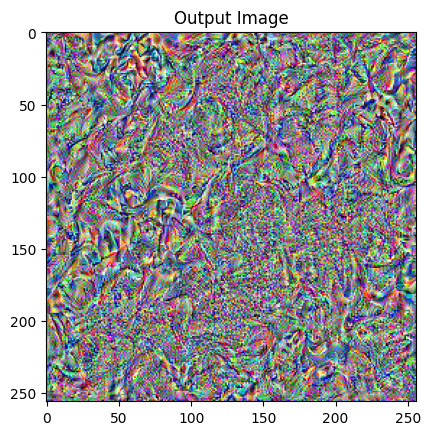

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv5 - L2

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

style_img = image_loader("style_img.jpg")

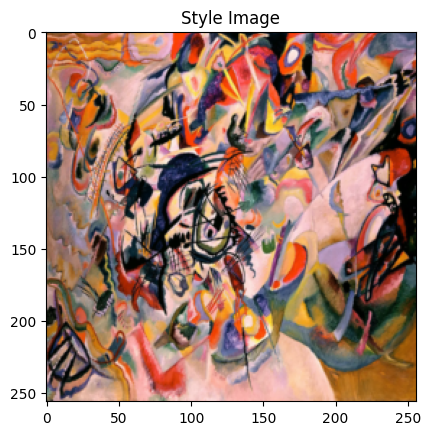

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(style_img, title='Style Image')

**Loss Functions**

In [ ]:
def gram_matrix(tensor):
    a, b, c, d = tensor.size()
    tensor = tensor.view(a * b, c * d)
    G = torch.mm(tensor, tensor.t())
    return G.div(a * b * c * d)

StyleLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
style_features = get_features(VGG19_pretrained, style_img)

In [ ]:
style_layers = ['conv_5']

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(style_img.shape).to(device)
target_img = target_img.requires_grad_(True)

optimizer = optim.Adam([target_img], lr=0.1)

In [ ]:
STEPS = 1000

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)

    style_loss = 0
    for layer in style_layers:
        target_gram = gram_matrix(target_features[layer])
        style_gram = gram_matrix(style_features[layer])
        style_loss += StyleLoss(style_gram, target_gram)

    style_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 100 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Style loss: {style_loss.item():.8f}")

        fname = '5.Conv5/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/1000] Style loss: 0.00000132
(256, 256, 3)
Epoch [101/1000] Style loss: 0.00000014
(256, 256, 3)
Epoch [201/1000] Style loss: 0.00000009
(256, 256, 3)
Epoch [301/1000] Style loss: 0.00000007
(256, 256, 3)
Epoch [401/1000] Style loss: 0.00000006
(256, 256, 3)
Epoch [501/1000] Style loss: 0.00000006
(256, 256, 3)
Epoch [601/1000] Style loss: 0.00000005
(256, 256, 3)
Epoch [701/1000] Style loss: 0.00000005
(256, 256, 3)
Epoch [801/1000] Style loss: 0.00000005
(256, 256, 3)
Epoch [901/1000] Style loss: 0.00000005
(256, 256, 3)


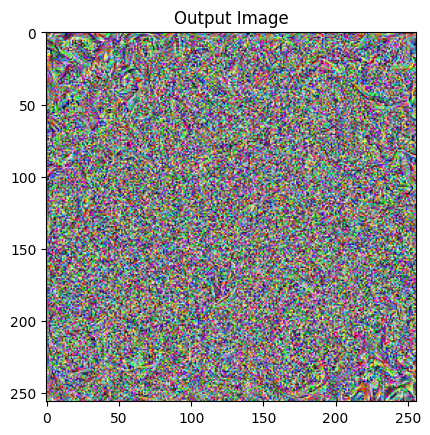

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv_Full

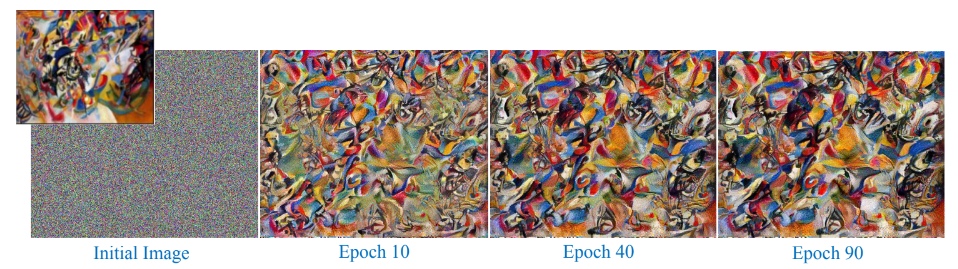

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

style_img = image_loader("style_img.jpg")

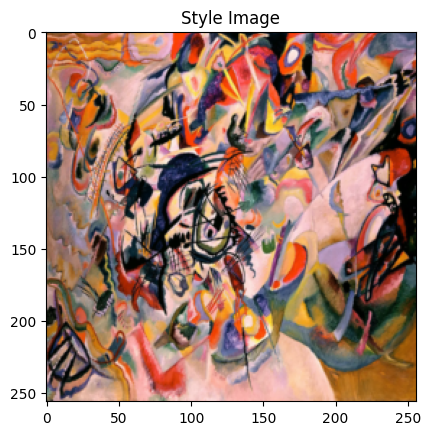

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(style_img, title='Style Image')

**Loss Functions**

In [ ]:
def gram_matrix(tensor):
    a, b, c, d = tensor.size()
    tensor = tensor.view(a * b, c * d)
    G = torch.mm(tensor, tensor.t())
    return G.div(a * b * c * d)

StyleLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
style_features = get_features(VGG19_pretrained, style_img)

In [ ]:
style_layers = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(style_img.shape).to(device)
target_img = target_img.requires_grad_(True)

optimizer = optim.Adam([target_img], lr=0.1)

In [ ]:
STEPS = 1000

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)

    style_loss = 0
    for layer in style_layers:
        target_gram = gram_matrix(target_features[layer])
        style_gram = gram_matrix(style_features[layer])
        style_loss += StyleLoss(style_gram, target_gram)

    style_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 100 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Style loss: {style_loss.item():.8f}")

        fname = '6.Conv_Full/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/1000] Style loss: 0.00025717
(256, 256, 3)
Epoch [101/1000] Style loss: 0.00000110
(256, 256, 3)
Epoch [201/1000] Style loss: 0.00000059
(256, 256, 3)
Epoch [301/1000] Style loss: 0.00000046
(256, 256, 3)
Epoch [401/1000] Style loss: 0.00000039
(256, 256, 3)
Epoch [501/1000] Style loss: 0.00000035
(256, 256, 3)
Epoch [601/1000] Style loss: 0.00000033
(256, 256, 3)
Epoch [701/1000] Style loss: 0.00000031
(256, 256, 3)
Epoch [801/1000] Style loss: 0.00000029
(256, 256, 3)
Epoch [901/1000] Style loss: 0.00000028
(256, 256, 3)


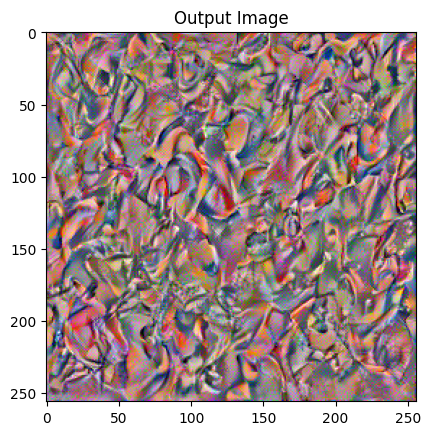

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Conv_Full 2

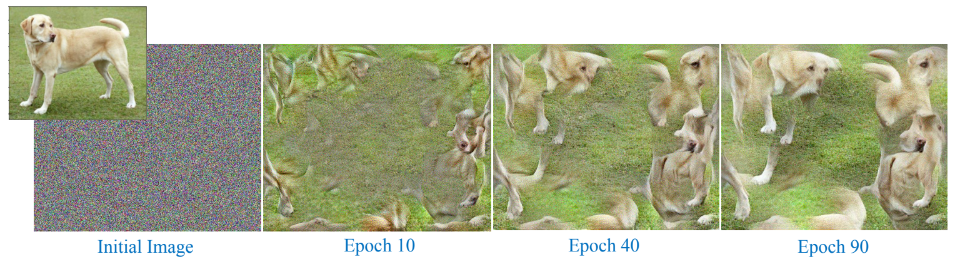

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

style_img = image_loader("style_img_2.jpg")

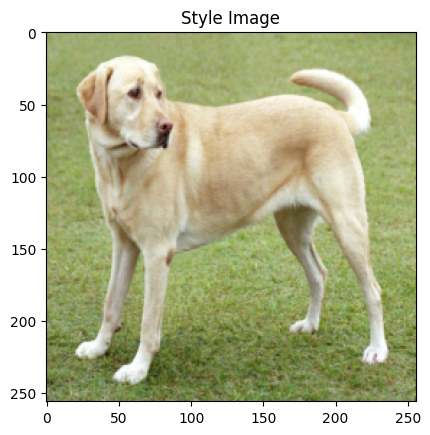

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(style_img, title='Style Image')

**Loss Functions**

In [ ]:
def gram_matrix(tensor):
    a, b, c, d = tensor.size()
    tensor = tensor.view(a * b, c * d)
    G = torch.mm(tensor, tensor.t())
    return G.div(a * b * c * d)

StyleLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

VGG19_pretrained = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
style_features = get_features(VGG19_pretrained, style_img)

In [ ]:
style_layers = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(style_img.shape).to(device)
target_img = target_img.requires_grad_(True)

optimizer = optim.Adam([target_img], lr=1)

In [ ]:
STEPS = 1000

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)

    style_loss = 0
    for layer in style_layers:
        target_gram = gram_matrix(target_features[layer])
        style_gram = gram_matrix(style_features[layer])
        style_loss += StyleLoss(style_gram, target_gram)

    style_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 100 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Style loss: {style_loss.item():.8f}")

        fname = '7.Conv_Full_2/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/1000] Style loss: 0.00025885
(256, 256, 3)
Epoch [101/1000] Style loss: 0.00000175
(256, 256, 3)
Epoch [201/1000] Style loss: 0.00000034
(256, 256, 3)
Epoch [301/1000] Style loss: 0.00000020
(256, 256, 3)
Epoch [401/1000] Style loss: 0.00000016
(256, 256, 3)
Epoch [501/1000] Style loss: 0.00000013
(256, 256, 3)
Epoch [601/1000] Style loss: 0.00000012
(256, 256, 3)
Epoch [701/1000] Style loss: 0.00000010
(256, 256, 3)
Epoch [801/1000] Style loss: 0.00000010
(256, 256, 3)
Epoch [901/1000] Style loss: 0.00000016
(256, 256, 3)


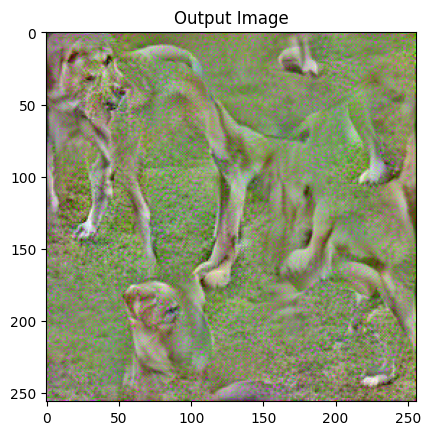

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()

### Random Net

Random Net được tạo ra ngẫu nhiên, không có khả năng học và khái quát cao. Do đó, nó không thể nắm bắt được các đặc điểm phong cách tinh tế của hình ảnh.

- vì G_Matrix không có thứ tự => loss vẫn thấp nhưng hình nhiễu

**Imports**

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

**Data**

In [ ]:
from PIL import Image
import torchvision.transforms as transforms

imsize = 256
img_transforms = transforms.Compose([
    transforms.Resize((imsize, imsize)),
    transforms.ToTensor()
])

In [ ]:
def image_loader(image_name):
    image = Image.open(image_name)
    image = img_transforms(image).unsqueeze(0)
    return image.to(device, torch.float)

style_img = image_loader("style_img_2.jpg")

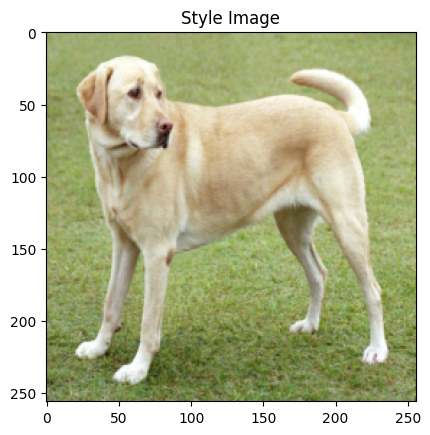

In [ ]:
def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)


plt.figure()
imshow(style_img, title='Style Image')

**Loss Functions**

In [ ]:
def gram_matrix(tensor):
    a, b, c, d = tensor.size()
    tensor = tensor.view(a * b, c * d)
    G = torch.mm(tensor, tensor.t())
    return G.div(a * b * c * d)

StyleLoss = nn.MSELoss()

**Model**

In [ ]:
from torchvision.models import vgg19

VGG19_pretrained = vgg19().features.eval()
for param in VGG19_pretrained.parameters():
    param.requires_grad_(False)

VGG19_pretrained.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
style_layers = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

In [ ]:
def get_features(pretrained_model, image):
    layers = {
        '0': 'conv_1',
        '5': 'conv_2',
        '10': 'conv_3',
        '19': 'conv_4',
        '28': 'conv_5'
    }
    features = {}
    x = image
    for name, pretrained_layer in pretrained_model._modules.items():
        x = pretrained_layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

In [ ]:
style_features = get_features(VGG19_pretrained, style_img)

**Training**

In [ ]:
import torch.optim as optim

target_img = torch.rand(style_img.shape).to(device)
target_img = target_img.requires_grad_(True)

optimizer = optim.Adam([target_img], lr=1)

In [ ]:
STEPS = 1000

for step in range(STEPS):
    optimizer.zero_grad()
    target_features = get_features(VGG19_pretrained, target_img)

    style_loss = 0
    for layer in style_layers:
        target_gram = gram_matrix(target_features[layer])
        style_gram = gram_matrix(style_features[layer])
        style_loss += StyleLoss(style_gram, target_gram)

    style_loss.backward()
    optimizer.step()

    with torch.no_grad():
        target_img.clamp_(0, 1)

    if step % 100 == 0:
        print(f"Epoch [{step+1}/{STEPS}] Style loss: {style_loss.item():.8f}")

        fname = '7.Conv_Full_2/at_%d.png' % (step+1)
        print(target_img[0].detach().cpu().permute(1, 2, 0).numpy().shape)
        mpl.image.imsave(fname, target_img[0].detach().cpu().permute(1, 2, 0).numpy())

Epoch [1/1000] Style loss: 0.00000000
(256, 256, 3)
Epoch [101/1000] Style loss: 0.00000000
(256, 256, 3)
Epoch [201/1000] Style loss: 0.00000000
(256, 256, 3)
Epoch [301/1000] Style loss: 0.00000000
(256, 256, 3)
Epoch [401/1000] Style loss: 0.00000000
(256, 256, 3)
Epoch [501/1000] Style loss: 0.00000000
(256, 256, 3)
Epoch [601/1000] Style loss: 0.00000000
(256, 256, 3)
Epoch [701/1000] Style loss: 0.00000000
(256, 256, 3)
Epoch [801/1000] Style loss: 0.00000000
(256, 256, 3)
Epoch [901/1000] Style loss: 0.00000000
(256, 256, 3)


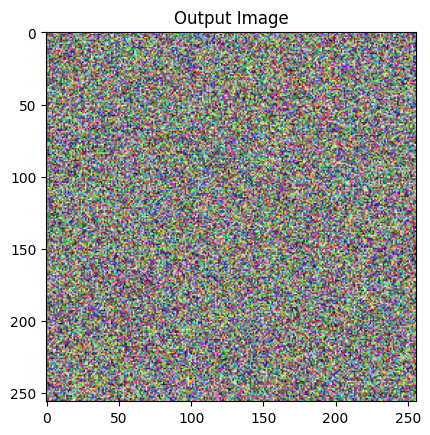

In [ ]:
plt.figure()
imshow(target_img.detach(), title='Output Image')
plt.show()